DATASET: https://www.kaggle.com/datasets/phylake1337/fire-dataset



In [ ]:
! pip install imutils

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
! pip install mpi4py

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.5 MB 11.8 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for mpi4py: filename=mpi4py-3.1.4-cp37-cp37m-linux_x86_64.whl size=2185770 sha256=9a695cc4a9e028782cc90d523d09ea2cd2b3d29b013d493c5ebeee91c9b29e7e
  Stored in directory: /root/.cache/pip/wheels/99/54/29/187b5768bbb7beeab6753bc30acf56f35bc8ca9c214a31e173
Successfully built mpi4py


In [ ]:
!pip install datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 441 kB 15.1 MB/s 
     |████████████████████████████████| 95 kB 5.7 MB/s 
     |████████████████████████████████| 212 kB 66.2 MB/s 
     |████████████████████████████████| 115 kB 55.4 MB/s 
     |████████████████████████████████| 163 kB 70.3 MB/s 
     |████████████████████████████████| 127 kB 63.3 MB/s 
     |████████████████████████████████| 115 kB 49.2 MB/s 
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
  Attempting uninstall: dill
    Found existing installation: dill 0.3.6
    Uninstalling dill-0.3.6:
      Successfully uninstalled dill-0.3.6


In [ ]:
!pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list
!kaggle datasets download -d phylake1337/fire-dataset

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ref                                                             title                                       size  lastUpdated          downloadCount  voteCount  usabilityRating  
--------------------------------------------------------------  -----------------------------------------  -----  -------------------  -------------  ---------  ---------------  
akshaydattatraykhare/diabetes-dataset                           Diabetes Dataset                             9KB  2022-10-06 08:55:25          12502        396  1.0              
whenamancodes/covid-19-coronavirus-pandemic-dataset             COVID -19 Coronavirus Pandemic Dataset      11KB  2022-09-30 04:05:11           9945        308  1.0              
thedevastator/240000-household-electricity-consumption-records  Household Electricity Consumption            3MB  2022-10-24 01:22:40            786         21  1.0              
akshay

In [ ]:
!unzip fire-dataset.zip

Archive:  fire-dataset.zip
  inflating: fire_dataset/fire_images/fire.1.png  
  inflating: fire_dataset/fire_images/fire.10.png  
  inflating: fire_dataset/fire_images/fire.100.png  
  inflating: fire_dataset/fire_images/fire.101.png  
  inflating: fire_dataset/fire_images/fire.102.png  
  inflating: fire_dataset/fire_images/fire.103.png  
  inflating: fire_dataset/fire_images/fire.104.png  
  inflating: fire_dataset/fire_images/fire.105.png  
  inflating: fire_dataset/fire_images/fire.106.png  
  inflating: fire_dataset/fire_images/fire.107.png  
  inflating: fire_dataset/fire_images/fire.108.png  
  inflating: fire_dataset/fire_images/fire.109.png  
  inflating: fire_dataset/fire_images/fire.11.png  
  inflating: fire_dataset/fire_images/fire.110.png  
  inflating: fire_dataset/fire_images/fire.111.png  
  inflating: fire_dataset/fire_images/fire.112.png  
  inflating: fire_dataset/fire_images/fire.113.png  
  inflating: fire_dataset/fire_images/fire.114.png  
  inflating: fire_datas

In [ ]:
#from mpi4py import MPI
import numpy as np
import time
import tensorflow as tf
import cv2
from imutils import paths
import os
import time
import random
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import img_to_array
import numpy as np

In [ ]:
comm = MPI.COMM_WORLD
size = comm.Get_size()
rank = comm.Get_rank()

In [ ]:
import os
from os import listdir
data = []
labels = []
d=[]
folder_dir = "/content/fire_dataset/fire_images"
for images in os.listdir(folder_dir):
 
    if (images.endswith(".png")):
      pathimg = "/content/fire_dataset/fire_images/"+str(images)
      image = cv2.imread(pathimg)
      image = cv2.resize(image,(50, 50))
      image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
      image = img_to_array(image)
      data.append(image)
      labels.append(0) # 0 is fire
      d.append((image,0))

In [ ]:
folder_dir = "/content/fire_dataset/non_fire_images"
for images in os.listdir(folder_dir):
 
    if (images.endswith(".png")):
      pathimg = "/content/fire_dataset/non_fire_images/"+str(images)
      image = cv2.imread(pathimg)
      if image is not None:
        #print(image.shape)
        image = cv2.resize(image,(50, 50))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        image = img_to_array(image)
        data.append(image)
        labels.append(1) # 1 is non-fire
        d.append((image,1))

In [ ]:
def data_split(a,b):
  each = (int)(len(d)/b)
  return d[a*each:(a+1)*each]


In [ ]:
def fn_modelfit(model,node):
    gw=[]
    gw1=[]
    for layer in model.layers:
        if node==0:
            if layer.name != 'flatten':
                print("MASTER: Accumulating and averaging out weights")
                print(layer.name)
                lw1=comm.recv(source=1,tag=10)
                lw2=comm.recv(source=2,tag=10)
                lw3=comm.recv(source=3,tag=10)
                lw4=comm.recv(source=4,tag=10)
                gw1=lw1+lw2+lw3+lw4
                gw1=gw1/4
                gw1=comm.bcast(gw1, root=0)
                gw.append(gw1)
                comm.Barrier()
        else:
            if layer.name != 'flatten':
                if node==5:
                    time.sleep(2)
                lw =layer.get_weights()[0]
                comm.send(lw, dest=0, tag=10)
                gw1=comm.bcast(gw1, root=0)
                np_gw1=np.array(gw1)
                layer.set_weights([np_gw1,np.ones(layer.get_weights()[1].shape)])
                comm.Barrier()
           
    if rank==0:
        return gw
    else:
        return None

In [ ]:
def exec(dt,node):
    labels=[]
    data=[]
    i=1
    a_size = 11
    local_weight = np.zeros(a_size,dtype=np.double)
    for i in dt:
        data.append(i[0])
        labels.append(i[1])
    data = np.array(data, dtype="float") / 255.0
    labels = np.array(labels)
#data=np.array([i[np.newaxis,...] for i in data])
    train_X = data
    train_y = labels
    VAL_PCT = 0.1  # lets reserve 10% of our data for validation
    val_size = int(len(data)*VAL_PCT)
    model=Sequential() 
    model.add(tf.keras.layers.Conv2D(filters = 32, kernel_size = (5, 5), activation = 'relu',data_format = "channels_last",
                           input_shape = (1,50,50,1)))
    model.add(tf.keras.layers.Conv2D(filters = 64, kernel_size = (5, 5), activation = 'relu', data_format = "channels_last"))
    #model.add(tf.keras.layers.ConvLSTM2D(filters = 128, kernel_size = (5, 5), activation = 'relu', data_format = "channels_last"))
    model.add(tf.keras.layers.Flatten()) 
    model.add(tf.keras.layers.Dense(units = 512, activation = 'relu'))
    model.add(tf.keras.layers.Dense(1, activation = "softmax"))
    train_X = data[:-val_size]
    train_y = labels[:-val_size]
    test_X = data[-val_size:]
    test_y = labels[-val_size:]
    print(train_X.shape)
    train_X=np.reshape(train_X,(-1, 1, 50, 50, 1))
    test_X = np.reshape(test_X,(-1, 1, 50, 50, 1))
    print(train_X.shape)
    EPOCHS = 1
    BATCH_SIZE = 8
    Iterations = 9
    steps_per_epoch = 1
    model.compile(loss = 'binary_crossentropy', optimizer = 'Adam', metrics = ["accuracy"])
    
    for i in range(Iterations):
        history = model.fit(x=train_X,y=train_y,steps_per_epoch=steps_per_epoch, epochs=EPOCHS,validation_data=(test_X,test_y),batch_size=BATCH_SIZE)
        weights=fn_modelfit(model,rank)
    #print(weights)
    if rank == 0:
        model.set_weights(weights)
        model.save('./model')

In [ ]:

if rank==0:
    d1=[]
    d1=data_split(rank,5)
    print("master working")
    exec(d1,0)
elif rank==1:
    print("Worker1 working")
    d2=[]
    d2=data_split(rank,5)
    exec(d2,1)
elif rank==2:
    print("Worker2 working")
    d3=[]
    d3=data_split(rank,5)
    exec(d3,2) 
elif rank==3:
    print("Worker3 working")
    d4=[]
    d4=data_split(rank,5)
    exec(d4,3)
elif rank==4:
    print("Worker4 working")
    d1=[]
    d1=data_split(rank,5)
    exec(d1,4)
    
#model.layers[1].set_weights(data)

In [ ]:
! mpirun --allow-run-as-root -np 4 python untitled2.py

Worker1 working
master working
2022-11-08 06:01:31.613626: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-11-08 06:01:31.661588: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
Worker2 working
2022-11-08 06:01:32.112189: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
Worker3 working
2022-11-08 06:01:33.732298: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
(225, 50, 50, 1)
(225, 1, 50, 50, 1)
(225, 50, 50, 1)
(225, 1, 50, 50, 1)
(225, 50, 50, 1)
(225, 1, 50, 50, 1)
(225, 50, 50, 1)
(225, 1, 50, 50, 1)
1/1 [==============================] - 16s 16s/step - loss: 0.6825 - accuracy: 0.0000e+00 - val_loss: 6.6156e-07 - val_accuracy: 0.0000e+00
M

### after running load the saved weights

In [ ]:
#model.load_weights('working_weights.h5')

##### predict output for our own image

In [ ]:
from PIL import Image

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPool2D, Flatten, Dense

In [ ]:
model = Sequential()
model.add(Conv2D(filters=32,kernel_size = (2,2),activation='relu',input_shape = (256,256,3)))
model.add(MaxPool2D())
model.add(Conv2D(filters=64,kernel_size=(2,2),activation='relu'))
model.add(MaxPool2D())
model.add(Conv2D(filters=128,kernel_size=(2,2),activation='relu'))
model.add(MaxPool2D())
model.add(Flatten())
model.add(Dense(64,activation='relu'))
model.add(Dense(32,activation = 'relu'))
model.add(Dense(1,activation = 'sigmoid'))

In [ ]:
from tensorflow.keras.metrics import Recall,AUC
from tensorflow.keras.utils import plot_model

In [ ]:
model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy',Recall(),AUC()])

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

In [ ]:
early_stoppping = EarlyStopping(monitor='val_loss',patience=5,restore_best_weights=True)
reduce_lr_on_plateau = ReduceLROnPlateau(monitor='val_loss',factor=0.1,patience=5)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
generator = ImageDataGenerator(
    rotation_range= 20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range = 2,
    zoom_range=0.2,
    rescale = 1/255,
    validation_split=0.2,
)

In [ ]:
import pandas as pd

In [ ]:
df = pd.DataFrame(columns=['path','label'])

#loop over fire images and label them 1
for dirname, _, filenames in os.walk('./fire_dataset/fire_images'):
    for filename in filenames:
        #print(os.path.join(dirname, filename))
        df = df.append(pd.DataFrame([[os.path.join(dirname, filename),'fire']],columns=['path','label']))

#loop over non fire images and label them 0
for dirname, _, filenames in os.walk('./fire_dataset/non_fire_images'):
    for filename in filenames:
        df = df.append(pd.DataFrame([[os.path.join(dirname, filename),'non_fire']],columns=['path','label']))
        #print(os.path.join(dirname, filename))

#shuffle the dataset for redistribute the labels
df = df.sample(frac=1).reset_index(drop=True)
df.head(10)

,path,label
0,./fire_dataset/non_fire_images/non_fire.160.png,non_fire
1,./fire_dataset/fire_images/fire.84.png,fire
2,./fire_dataset/non_fire_images/non_fire.189.png,non_fire
3,./fire_dataset/fire_images/fire.376.png,fire
4,./fire_dataset/non_fire_images/non_fire.186.png,non_fire
5,./fire_dataset/fire_images/fire.617.png,fire
6,./fire_dataset/non_fire_images/non_fire.168.png,non_fire
7,./fire_dataset/non_fire_images/non_fire.158.png,non_fire
8,./fire_dataset/fire_images/fire.643.png,fire
9,./fire_dataset/fire_images/fire.608.png,fire


In [ ]:
from tensorflow.keras.preprocessing import image as imageee
def shaper(row):
    shape = imageee.load_img(row['path']).size
    row['height'] = shape[1]
    row['width'] = shape[0]
    return row
df = df.apply(shaper,axis=1)
df.head(5)

,path,label,height,width
0,./fire_dataset/non_fire_images/non_fire.160.png,non_fire,666,2560
1,./fire_dataset/fire_images/fire.84.png,fire,541,1000
2,./fire_dataset/non_fire_images/non_fire.189.png,non_fire,304,540
3,./fire_dataset/fire_images/fire.376.png,fire,405,720
4,./fire_dataset/non_fire_images/non_fire.186.png,non_fire,403,600


In [ ]:
train_gen = generator.flow_from_dataframe(df,x_col='path',y_col='label',images_size=(256,256),class_mode='binary',subset='training')
val_gen = generator.flow_from_dataframe(df,x_col='path',y_col='label',images_size=(256,256),class_mode='binary',subset='validation')

Found 800 validated image filenames belonging to 2 classes.
Found 199 validated image filenames belonging to 2 classes.


In [ ]:
model.fit(x=train_gen,batch_size=32,epochs=5,validation_data=val_gen,callbacks=[early_stoppping,reduce_lr_on_plateau])

Epoch 1/5
25/25 [==============================] - 54s 2s/step - loss: 0.4747 - accuracy: 0.7900 - recall: 0.3850 - auc: 0.7863 - val_loss: 0.1727 - val_accuracy: 0.9497 - val_recall: 0.7727 - val_auc: 0.9822 - lr: 0.0010
Epoch 2/5
25/25 [==============================] - 40s 2s/step - loss: 0.1419 - accuracy: 0.9438 - recall: 0.8600 - auc: 0.9837 - val_loss: 0.0871 - val_accuracy: 0.9598 - val_recall: 0.8409 - val_auc: 0.9955 - lr: 0.0010
Epoch 3/5
25/25 [==============================] - 40s 2s/step - loss: 0.1600 - accuracy: 0.9312 - recall: 0.8750 - auc: 0.9784 - val_loss: 0.0961 - val_accuracy: 0.9698 - val_recall: 0.8636 - val_auc: 0.9947 - lr: 0.0010
Epoch 4/5
25/25 [==============================] - 40s 2s/step - loss: 0.1388 - accuracy: 0.9513 - recall: 0.8700 - auc: 0.9816 - val_loss: 0.0850 - val_accuracy: 0.9799 - val_recall: 0.9545 - val_auc: 0.9958 - lr: 0.0010
Epoch 5/5
25/25 [==============================] - 39s 2s/step - loss: 0.1262 - accuracy: 0.9475 - recall: 0.865

In [ ]:
model_classes = ['fire','non-fire']

In [ ]:
model.save_weights('working_weights.h5')

## Prediction

In [ ]:
def predict_final(pathimg):
  img = imageee.load_img(pathimg)
  img = imageee.img_to_array(img)/255
  img = tf.image.resize(img,(256,256))
  img = tf.expand_dims(img,axis=0)
  index = int(tf.round(model.predict(x=img)).numpy()[0][0])
  print(model_classes[index])

1/1 [==============================] - 0s 28ms/step
non-fire


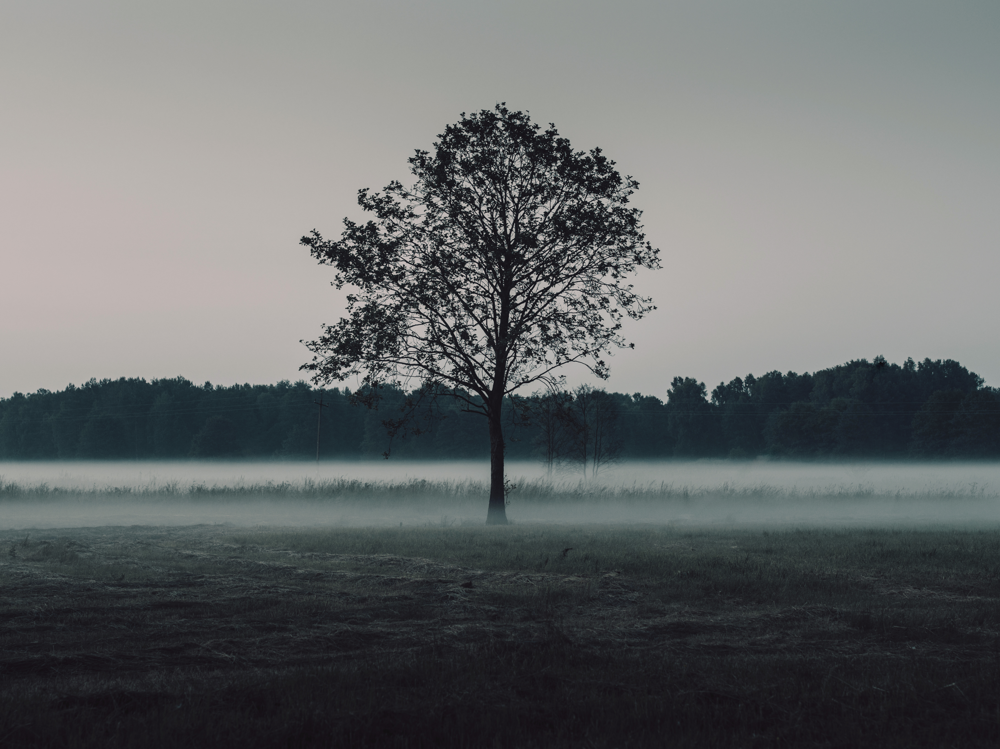

In [ ]:
predict_final('tree.png')
Image.open('tree.png')

1/1 [==============================] - 0s 16ms/step
fire


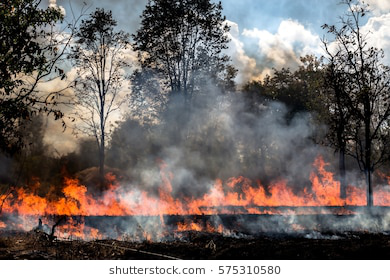

In [ ]:
predict_final('fire.png')
Image.open('fire.png')

1/1 [==============================] - 0s 26ms/step
fire


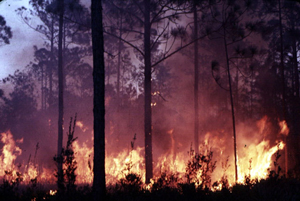

In [ ]:
predict_final('firetest2.png')
Image.open('firetest2.png')

1/1 [==============================] - 0s 16ms/step
non-fire


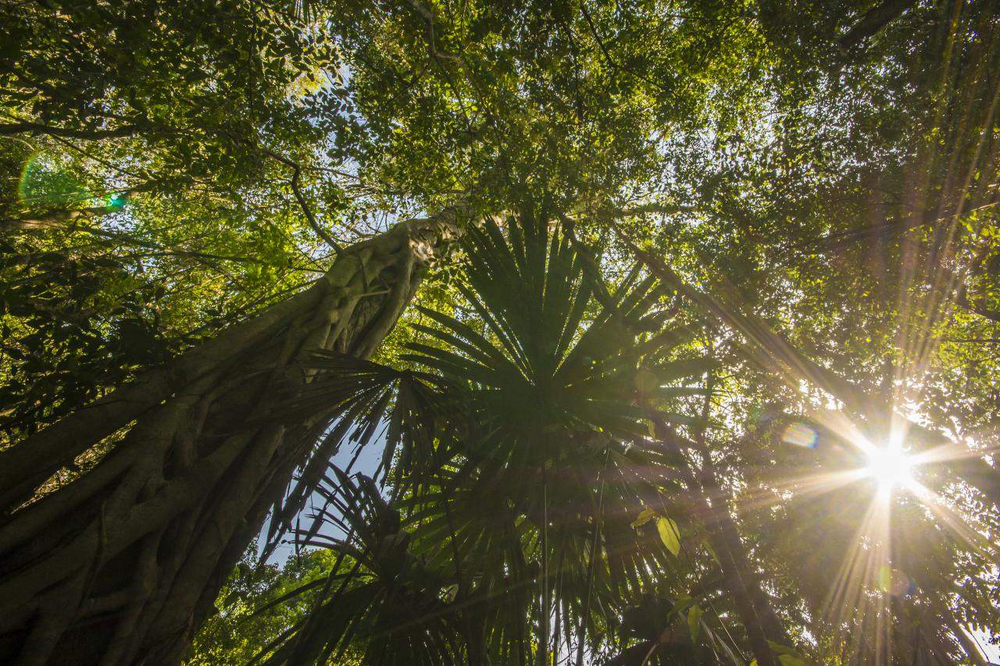

In [ ]:
predict_final('forest.png')
Image.open('forest.png')